In [4]:
import pandas as pd
import numpy as np
import hvplot.pandas
import holoviews as hv
from holoviews import dim, opts
from utils.plotting import hvplot_fc, hvplot_fc_nwlevel, plot_as_graph
from nilearn.plotting import view_connectome

In [5]:
import os.path as osp
import pandas as pd
import numpy as pn
from utils.basics import ATLASES_DIR, FB_400ROI_ATLAS_NAME
from utils.plotting import nw_color_map
SOLUTION = 'CL02_0p001'
ATLAS_NAME = FB_400ROI_ATLAS_NAME

In [6]:
ATLASINFO_PATH = osp.join(ATLASES_DIR,ATLAS_NAME,'{ATLAS_NAME}.roi_info.csv'.format(ATLAS_NAME=ATLAS_NAME))
roi_info       = pd.read_csv(ATLASINFO_PATH)
roi_info

,ROI_ID,Hemisphere,Network,ROI_Name,pos_R,pos_A,pos_S,color_R,color_G,color_B,RGB
0,1,LH,Vis,LH_Vis_1,-32,-42,-20,120,17,128,#781180
1,2,LH,Vis,LH_Vis_2,-30,-32,-18,120,17,129,#781181
2,3,LH,Vis,LH_Vis_3,-36,-62,-16,120,17,130,#781182
3,4,LH,Vis,LH_Vis_4,-24,-54,-8,120,17,131,#781183
4,5,LH,Vis,LH_Vis_5,-24,-72,-10,120,17,132,#781184
...,...,...,...,...,...,...,...,...,...,...,...
375,376,RH,Default,RH_Default_pCunPCC_9,8,-50,44,208,64,77,#d0404d
376,377,RH,Subcortical,RH_Subcortical_Caudate,14,13,-7,255,255,0,#ffff00
377,378,RH,Subcortical,RH_Subcortical_Putamen,26,4,-1,255,255,0,#ffff00
378,379,RH,Subcortical,RH_Subcortical_Pallidum,22,0,0,255,255,0,#ffff00


In [7]:
networks = list(roi_info['Network'].unique())
print(networks)

['Vis', 'SomMot', 'DorsAttn', 'SalVentAttn', 'Limbic', 'Cont', 'Default', 'Subcortical']


In [8]:
data_f1GTf2 = np.loadtxt('/data/SFIMJGC_Introspec/2023_fc_introspection/code/fc_introspection/resources/nbs/{ATLAS_NAME}/NBS_{s}_Results/NBS_{s}_F1gtF2.edge'.format(s=SOLUTION, ATLAS_NAME=ATLAS_NAME))
print('/data/SFIMJGC_Introspec/2023_fc_introspection/code/fc_introspection/resources/nbs/{ATLAS_NAME}/NBS_{s}_Results/NBS_{s}_F1gtF2.edge'.format(s=SOLUTION, ATLAS_NAME=ATLAS_NAME))
data_f1GTf2 = pd.DataFrame(data_f1GTf2,
                           index   = roi_info.set_index(['Hemisphere','Network','ROI_Name','ROI_ID','RGB']).index, 
                           columns = roi_info.set_index(['Hemisphere','Network','ROI_Name','ROI_ID','RGB']).index)

/data/SFIMJGC_Introspec/2023_fc_introspection/code/fc_introspection/resources/nbs/Schaefer2018_400Parcels_7Networks_AAL2/NBS_CL02_0p001_Results/NBS_CL02_0p001_F1gtF2.edge


In [9]:
data_f2GTf1 = np.loadtxt('/data/SFIMJGC_Introspec/2023_fc_introspection/code/fc_introspection/resources/nbs/{ATLAS_NAME}/NBS_{s}_Results/NBS_{s}_F2gtF1.edge'.format(s=SOLUTION, ATLAS_NAME=ATLAS_NAME))
print('/data/SFIMJGC_Introspec/2023_fc_introspection/code/fc_introspection/resources/nbs/{ATLAS_NAME}/NBS_{s}_Results/NBS_{s}_F2gtF1.edge'.format(s=SOLUTION, ATLAS_NAME=ATLAS_NAME))
data_f2GTf1 = pd.DataFrame(data_f2GTf1,
                           index   = roi_info.set_index(['Hemisphere','Network','ROI_Name','ROI_ID','RGB']).index, 
                           columns = roi_info.set_index(['Hemisphere','Network','ROI_Name','ROI_ID','RGB']).index)

/data/SFIMJGC_Introspec/2023_fc_introspection/code/fc_introspection/resources/nbs/Schaefer2018_400Parcels_7Networks_AAL2/NBS_CL02_0p001_Results/NBS_CL02_0p001_F2gtF1.edge


In [10]:
data = data_f1GTf2 - data_f2GTf1

In [11]:
hvplot_fc(data.loc[:,networks,:].T.loc[:,networks,:].T, by='Network', add_color_segments=True, add_labels=True, cmap=['#4472C4','#ffffff','#ED7D31']) + \
hvplot_fc(data_f1GTf2.loc[:,networks,:].T.loc[:,networks,:].T, by='Network', add_color_segments=True, add_labels=True, cmap=['#4472C4','#ffffff','#ED7D31']) + \
hvplot_fc(-data_f2GTf1.loc[:,networks,:].T.loc[:,networks,:].T, by='Network', add_color_segments=True, add_labels=True, cmap=['#4472C4','#ffffff','#ED7D31'])

:Layout
   .Overlay.I   :Overlay
      .HeatMap.I   :HeatMap   [columns,index]   (value)
      .HLine.I     :HLine   [x,y]
      .VLine.I     :VLine   [x,y]
      .HLine.II    :HLine   [x,y]
      .VLine.II    :VLine   [x,y]
      .HLine.III   :HLine   [x,y]
      .VLine.III   :VLine   [x,y]
      .HLine.IV    :HLine   [x,y]
      .VLine.IV    :VLine   [x,y]
      .HLine.V     :HLine   [x,y]
      .VLine.V     :VLine   [x,y]
      .HLine.VI    :HLine   [x,y]
      .VLine.VI    :VLine   [x,y]
      .HLine.VII   :HLine   [x,y]
      .VLine.VII   :VLine   [x,y]
      .HLine.VIII  :HLine   [x,y]
      .VLine.VIII  :VLine   [x,y]
      .HLine.IX    :HLine   [x,y]
      .VLine.IX    :VLine   [x,y]
      .HLine.X     :HLine   [x,y]
      .VLine.X     :VLine   [x,y]
      .HLine.XI    :HLine   [x,y]
      .VLine.XI    :VLine   [x,y]
      .Segments.I  :Segments   [x0,y0,x1,y1]   (Networks)
      .Segments.II :Segments   [x0,y0,x1,y1]   (Networks)
   .Overlay.II  :Overlay
      .HeatMap.I   :HeatMap   [columns,index]   (value)
      .HLine.I     :HLine   [x,y]
      .VLine.I     :VLine   [x,y]
      .HLine.II    :HLine   [x,y]
      .VLine.II    :VLine   [x,y]
      .HLine.III   :HLine   [x,y]
      .VLine.III   :VLine   [x,y]
      .HLine.IV    :HLine   [x,y]
      .VLine.IV    :VLine   [x,y]
      .HLine.V     :HLine   [x,y]
      .VLine.V     :VLine   [x,y]
      .HLine.VI    :HLine   [x,y]
      .VLine.VI    :VLine   [x,y]
      .HLine.VII   :HLine   [x,y]
      .VLine.VII   :VLine   [x,y]
      .HLine.VIII  :HLine   [x,y]
      .VLine.VIII  :VLine   [x,y]
      .HLine.IX    :HLine   [x,y]
      .VLine.IX    :VLine   [x,y]
      .HLine.X     :HLine   [x,y]
      .VLine.X     :VLine   [x,y]
      .HLine.XI    :HLine   [x,y]
      .VLine.XI    :VLine   [x,y]
      .Segments.I  :Segments   [x0,y0,x1,y1]   (Networks)
      .Segments.II :Segments   [x0,y0,x1,y1]   (Networks)
   .Overlay.III :Overlay
      .HeatMap.I   :HeatMap   [columns,index]   (value)
      .HLine.I     :HLine   [x,y]
      .VLine.I     :VLine   [x,y]
      .HLine.II    :HLine   [x,y]
      .VLine.II    :VLine   [x,y]
      .HLine.III   :HLine   [x,y]
      .VLine.III   :VLine   [x,y]
      .HLine.IV    :HLine   [x,y]
      .VLine.IV    :VLine   [x,y]
      .HLine.V     :HLine   [x,y]
      .VLine.V     :VLine   [x,y]
      .HLine.VI    :HLine   [x,y]
      .VLine.VI    :VLine   [x,y]
      .HLine.VII   :HLine   [x,y]
      .VLine.VII   :VLine   [x,y]
      .HLine.VIII  :HLine   [x,y]
      .VLine.VIII  :VLine   [x,y]
      .HLine.IX    :HLine   [x,y]
      .VLine.IX    :VLine   [x,y]
      .HLine.X     :HLine   [x,y]
      .VLine.X     :VLine   [x,y]
      .HLine.XI    :HLine   [x,y]
      .VLine.XI    :VLine   [x,y]
      .Segments.I  :Segments   [x0,y0,x1,y1]   (Networks)
      .Segments.II :Segments   [x0,y0,x1,y1]   (Networks)

***

In [12]:
hvplot_fc(data.astype(int), ATLASINFO_PATH, add_labels=True, add_color_segments=True, clim=(-1,1)) + hvplot_fc(data.loc[:,networks,:].T.loc[:,networks,:].T, by='Network', add_color_segments=True, add_labels=True)

:Layout
   .Overlay.I  :Overlay
      .HeatMap.I   :HeatMap   [columns,index]   (value)
      .HLine.I     :HLine   [x,y]
      .VLine.I     :VLine   [x,y]
      .HLine.II    :HLine   [x,y]
      .VLine.II    :VLine   [x,y]
      .HLine.III   :HLine   [x,y]
      .VLine.III   :VLine   [x,y]
      .HLine.IV    :HLine   [x,y]
      .VLine.IV    :VLine   [x,y]
      .HLine.V     :HLine   [x,y]
      .VLine.V     :VLine   [x,y]
      .HLine.VI    :HLine   [x,y]
      .VLine.VI    :VLine   [x,y]
      .HLine.VII   :HLine   [x,y]
      .VLine.VII   :VLine   [x,y]
      .HLine.VIII  :HLine   [x,y]
      .VLine.VIII  :VLine   [x,y]
      .HLine.IX    :HLine   [x,y]
      .VLine.IX    :VLine   [x,y]
      .HLine.X     :HLine   [x,y]
      .VLine.X     :VLine   [x,y]
      .HLine.XI    :HLine   [x,y]
      .VLine.XI    :VLine   [x,y]
      .HLine.XII   :HLine   [x,y]
      .VLine.XII   :VLine   [x,y]
      .HLine.XIII  :HLine   [x,y]
      .VLine.XIII  :VLine   [x,y]
      .HLine.XIV   :HLine   [x,y]
      .VLine.XIV   :VLine   [x,y]
      .HLine.XV    :HLine   [x,y]
      .VLine.XV    :VLine   [x,y]
      .HLine.XVI   :HLine   [x,y]
      .VLine.XVI   :VLine   [x,y]
      .HLine.XVII  :HLine   [x,y]
      .VLine.XVII  :VLine   [x,y]
      .HLine.XVIII :HLine   [x,y]
      .VLine.XVIII :VLine   [x,y]
      .HLine.XIX   :HLine   [x,y]
      .VLine.XIX   :VLine   [x,y]
      .Segments.I  :Segments   [x0,y0,x1,y1]   (Networks)
      .Segments.II :Segments   [x0,y0,x1,y1]   (Hemispheres)
   .Overlay.II :Overlay
      .HeatMap.I   :HeatMap   [columns,index]   (value)
      .HLine.I     :HLine   [x,y]
      .VLine.I     :VLine   [x,y]
      .HLine.II    :HLine   [x,y]
      .VLine.II    :VLine   [x,y]
      .HLine.III   :HLine   [x,y]
      .VLine.III   :VLine   [x,y]
      .HLine.IV    :HLine   [x,y]
      .VLine.IV    :VLine   [x,y]
      .HLine.V     :HLine   [x,y]
      .VLine.V     :VLine   [x,y]
      .HLine.VI    :HLine   [x,y]
      .VLine.VI    :VLine   [x,y]
      .HLine.VII   :HLine   [x,y]
      .VLine.VII   :VLine   [x,y]
      .HLine.VIII  :HLine   [x,y]
      .VLine.VIII  :VLine   [x,y]
      .HLine.IX    :HLine   [x,y]
      .VLine.IX    :VLine   [x,y]
      .HLine.X     :HLine   [x,y]
      .VLine.X     :VLine   [x,y]
      .HLine.XI    :HLine   [x,y]
      .VLine.XI    :VLine   [x,y]
      .Segments.I  :Segments   [x0,y0,x1,y1]   (Networks)
      .Segments.II :Segments   [x0,y0,x1,y1]   (Networks)

In [13]:
hvplot_fc(-data_f2GTf1.loc[:,networks,:].T.loc[:,networks,:].T, by='Network', add_color_segments=True, add_labels=True)

:Overlay
   .HeatMap.I   :HeatMap   [columns,index]   (value)
   .HLine.I     :HLine   [x,y]
   .VLine.I     :VLine   [x,y]
   .HLine.II    :HLine   [x,y]
   .VLine.II    :VLine   [x,y]
   .HLine.III   :HLine   [x,y]
   .VLine.III   :VLine   [x,y]
   .HLine.IV    :HLine   [x,y]
   .VLine.IV    :VLine   [x,y]
   .HLine.V     :HLine   [x,y]
   .VLine.V     :VLine   [x,y]
   .HLine.VI    :HLine   [x,y]
   .VLine.VI    :VLine   [x,y]
   .HLine.VII   :HLine   [x,y]
   .VLine.VII   :VLine   [x,y]
   .HLine.VIII  :HLine   [x,y]
   .VLine.VIII  :VLine   [x,y]
   .HLine.IX    :HLine   [x,y]
   .VLine.IX    :VLine   [x,y]
   .HLine.X     :HLine   [x,y]
   .VLine.X     :VLine   [x,y]
   .HLine.XI    :HLine   [x,y]
   .VLine.XI    :VLine   [x,y]
   .Segments.I  :Segments   [x0,y0,x1,y1]   (Networks)
   .Segments.II :Segments   [x0,y0,x1,y1]   (Networks)

***

In [14]:
hvplot_fc_nwlevel(data_f1GTf2, add_net_colors=True, add_net_labels=True, cmap='Reds', clim_max=75, mode='percent') + hvplot_fc_nwlevel(data_f2GTf1, add_net_colors=True, add_net_labels=True, cmap='Blues', clim_max=5, mode='count')

:Layout
   .Overlay.I  :Overlay
      .HeatMap.I   :HeatMap   [columns,index]   (value)
      .Labels.I    :Labels   [columns,index]   (value)
      .Segments.I  :Segments   [x0,y0,x1,y1]   (Networks)
      .Segments.II :Segments   [x0,y0,x1,y1]   (Networks)
   .Overlay.II :Overlay
      .HeatMap.I   :HeatMap   [columns,index]   (value)
      .Labels.I    :Labels   [columns,index]   (value)
      .Segments.I  :Segments   [x0,y0,x1,y1]   (Networks)
      .Segments.II :Segments   [x0,y0,x1,y1]   (Networks)

***

In [15]:
import networkx as nx
from sklearn.preprocessing import MinMaxScaler
from utils.plotting import get_node_positions
from nxviz.utils import node_table, edge_table
import matplotlib.pyplot as plt
from nxviz import plots, nodes, edges, lines
def plot_as_graph(data,figsize=(10,10),edge_weight=2,title=None, hemi_gap=5, show_pos=True, show_neg=True, layout='circos', show_degree=True, node_min_size=0.002, node_max_size=0.015,
                  pos_edges_color='#ED7D31', neg_edges_color='#4472C4'):
    # Check inputs meet expectations
    assert isinstance(data,pd.DataFrame),    "++ERROR [plot_as_graph]:  input data expected to be a pandas dataframe"
    assert 'ROI_ID'     in data.index.names, "++ERROR [plot_as_graph]:  input data expected to have one column named ROI_ID"
    assert 'Hemisphere' in data.index.names, "++ERROR [plot_as_graph]:  input data expected to have one column named Hemisphere"
    assert 'Network'    in data.index.names, "++ERROR [plot_as_graph]:  input data expected to have one column named Network"
    assert 'RGB'    in data.index.names,     "++ERROR [plot_as_graph]: input data expected to have one column named RGB"
    assert layout in ['circos','spring','kamada_kawai','spectral'], "++ ERROR [plot_as_graph] Unknown layout"
    roi_info = pd.DataFrame(index=data.index).reset_index()
    G_pos, G_neg, G = None, None, None
    
    # Convert input to ints (this function only works for unweigthed graphs)
    fdata          = data.copy().astype('int')
    fdata.index    = fdata.index.get_level_values('ROI_ID')
    fdata.columns  = fdata.index
    
    # Create basic Graph
    # ==================
    G = nx.from_pandas_adjacency(fdata.abs())
    
    # Add information about hemisphere and network
    # ============================================
    hemi_attribs      = {row['ROI_ID']:row['Hemisphere'] for r,row in roi_info.iterrows()}
    nw_attribs        = {row['ROI_ID']:row['Network'] for r,row in roi_info.iterrows()}
    lab_attribs       = {row['ROI_ID']:row['ROI_Name'] for r,row in roi_info.iterrows()}
    col_attribs       = {row['ROI_ID']:row['RGB'] for r,row in roi_info.iterrows()}
    alpha_attribs     = {row['ROI_ID']:.8  for r,row in roi_info.iterrows()}
    same_size_attribs = {row['ROI_ID']:node_min_size for r,row in roi_info.iterrows()}
    id_attribs        = {row['ROI_ID']:row['ROI_ID'] for r,row in roi_info.iterrows()}
    degree_centr_attribs = {r:v for r,v in zip(list(nx.degree_centrality(G).keys()), MinMaxScaler(feature_range=(0.001,0.01)).fit_transform(np.array(list(nx.degree_centrality(G).values())).reshape(-1,1)).flatten())}
    degree_attribs       = dict(G.degree())
    size_attribs      = {r:v for r,v in zip(list(degree_centr_attribs.keys()), MinMaxScaler(feature_range=(node_min_size,node_max_size)).fit_transform(np.array(list(nx.degree_centrality(G).values())).reshape(-1,1)).flatten())}
    
    nx.set_node_attributes(G,hemi_attribs,'Hemisphere')
    nx.set_node_attributes(G,nw_attribs,'Network')
    nx.set_node_attributes(G,lab_attribs,'ROI_Name')
    nx.set_node_attributes(G,col_attribs,'RGB')
    nx.set_node_attributes(G,id_attribs,'ROI_ID')
    nx.set_node_attributes(G,degree_centr_attribs,'Degree_Centrality')
    nx.set_node_attributes(G,degree_attribs,'Degree')
    nx.set_node_attributes(G,nx.eigenvector_centrality(G),'Eigenvector_Centrality')
    nx.set_node_attributes(G,nx.pagerank(G),'Page_Rank')

    if show_degree:
        nx.set_node_attributes(G,size_attribs,'Size')
    else:
        nx.set_node_attributes(G,same_size_attribs,'Size')
    nx.set_node_attributes(G,alpha_attribs,'Alpha')
    # Add edge attributes based on which model they represent
    # =======================================================
    # Count the input values
    val_counts = pd.Series(fdata.values.flatten()).value_counts()
    # Check for the presence of positive edges
    if 1 in val_counts.index:
        #fdata_pos will have 1s for edges in positive model, zero anywhere else
        fdata_pos              = fdata.copy()
        fdata_pos[fdata_pos<0] = 0 # Removing -1 from positive graph
        G_pos = nx.from_pandas_adjacency(fdata_pos)
    # Check for the present of negative edges
    if -1 in val_counts.index:
        #fdata_pos will have 1s for edges in negative model, zero anywhere else
        fdata_neg              = fdata.copy() * -1
        fdata_neg[fdata_neg<0] = 0    # Removing 1 from negative graph
        G_neg = nx.from_pandas_adjacency(fdata_neg)
    # Create Graph with all nodes (for positioning purposes - edges do not matter)
    # Add information about positive or negative edge
    model_attribs = {}
    if G_pos is not None:
        for edge in G_pos.edges:
            model_attribs[edge] = 'pos'
    if G_neg is not None:
        for edge in G_neg.edges:
            model_attribs[edge] = 'neg'
    nx.set_edge_attributes(G,model_attribs,'Model')

    # Obtain Node Positions
    if layout == 'circos':
        pos =  get_node_positions(roi_info, hemi_gap=hemi_gap)
    if layout == 'spring':
        pos = nx.spring_layout(G)
    if layout == 'kamada_kawai':
        pos = nx.kamada_kawai_layout(G)
    if layout == 'spectral':
        pos = nx.spectral_layout(G)
    x_pos = np.array([i[0] for i in pos.values()])
    y_pos = np.array([i[1] for i in pos.values()])
    x_min = np.quantile(x_pos,.05)
    x_max = np.quantile(x_pos,.95)
    y_min = np.quantile(y_pos,.05)
    y_max = np.quantile(y_pos,.95)
    # Node Styling
    nt  = node_table(G)
    node_color = roi_info.set_index('ROI_ID')['RGB']
    node_alpha = pd.Series(1.0, index=node_color.index)
    node_size  = pd.Series(0.01, index=node_color.index)
    # Positive Edges Styling
    if G_pos is not None:
        pos_et         = edge_table(G_pos)
        pos_et_color   = pd.Series(pos_edges_color, index=range(pos_et.shape[0]))
        pos_lw         = edge_weight*pos_et["weight"] 
        pos_alpha      = pd.Series(0.5, index=range(pos_et.shape[0]))
    # Negative Edges Styling
    if G_neg is not None:
        neg_et         = edge_table(G_neg)
        neg_et_color   = pd.Series(neg_edges_color, index=range(neg_et.shape[0]))#edges.edge_colors(et, nt=None, color_by=None, node_color_by=None)
        neg_lw         = edge_weight*neg_et["weight"] 
        neg_alpha      = pd.Series(0.3, index=range(neg_et.shape[0]))
    # Create plot
    # ===========
    fig, ax = plt.subplots(1,1,figsize=figsize)
    
    # 1. Add nodes to the plot
    if show_degree:
        patches = nodes.node_glyphs( nt, pos, node_color=nt['RGB'], alpha=nt['Alpha'], size=nt['Size'], **{'edgecolor':'k', 'linewidth':0.5})
    else:
        patches = nodes.node_glyphs( nt, pos, node_color=nt['RGB'], alpha=nt['Alpha'], size=nt['Size'], **{'edgecolor':'k', 'linewidth':0.5})
    for patch in patches: 
        ax.add_patch(patch)
        
    # 2. Add edges to the plot
    if (G_pos is not None) & (show_pos is True): 
        if layout == 'circos':
            patches = lines.circos( pos_et, pos, edge_color=pos_et_color, alpha=pos_alpha, lw=pos_lw, aes_kw={"fc": "none"} )
        else:
            patches = lines.line( pos_et, pos, edge_color=pos_et_color, alpha=pos_alpha, lw=pos_lw, aes_kw={"fc": "none"} )
        for patch in patches: 
            ax.add_patch(patch)
    if (G_neg is not None) & (show_neg is True):
        if layout == 'circos':
            patches = lines.circos( neg_et, pos, edge_color=neg_et_color, alpha=neg_alpha, lw=neg_lw, aes_kw={"fc": "none"} ) 
        else:
            patches = lines.line( neg_et, pos, edge_color=neg_et_color, alpha=neg_alpha, lw=neg_lw, aes_kw={"fc": "none"} ) 
        for patch in patches: 
            ax.add_patch(patch)
    if title is not None:
       plt.title(title)
    plots.rescale(G) 
    plots.aspect_equal()
    plots.despine()
    plt.close()
    if layout != 'circos':
        ax.set_xlim(x_min,x_max)
        ax.set_ylim(y_min,y_max)
    return G,pos,fig

In [16]:
G_f1GTf2,pos_f1GTf2,fig_f1GTf2 = plot_as_graph(data_f1GTf2, layout='circos', edge_weight=.2, show_degree=True)
G_f2GTf1,pos_f2GTf1,fig_f2GTf1 = plot_as_graph(-data_f2GTf1, layout='circos', edge_weight=.2, show_degree=True)

In [17]:
G,pos,fig = plot_as_graph(data_f1GTf2-data_f2GTf1, layout='circos', edge_weight=.2, show_degree=True)

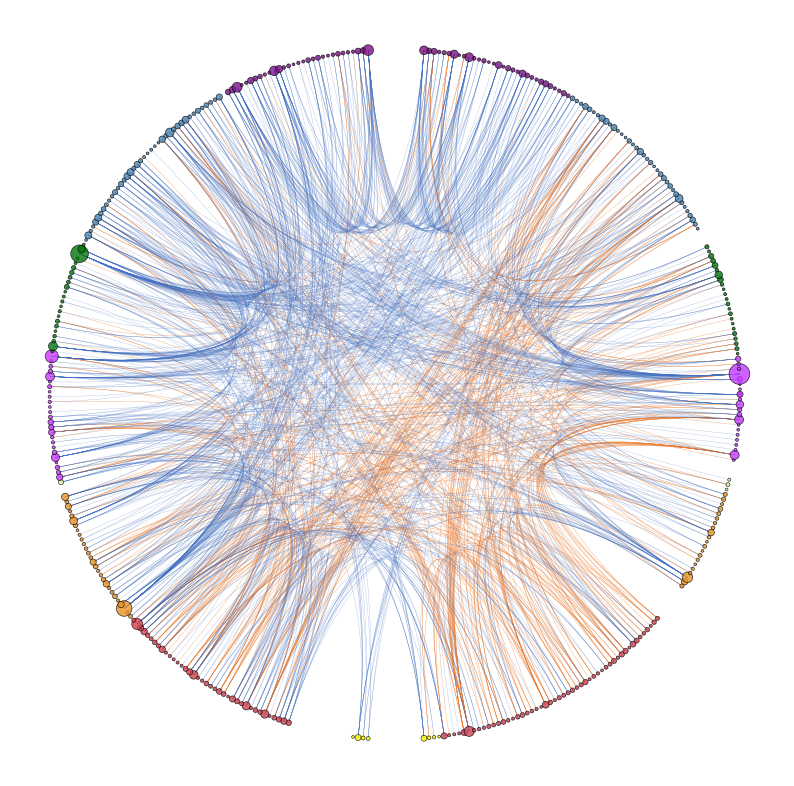

In [18]:
fig

In [123]:
Gnt_f1GTf2 = node_table(G_f1GTf2)[::-1]
Gnt_f1GTf2[Gnt_f1GTf2['Degree']>4.9].sort_values(by='Degree', ascending=False)

,Hemisphere,Network,ROI_Name,RGB,ROI_ID,Degree_Centrality,Degree,Eigenvector_Centrality,Page_Rank,Size,Alpha
182,LH,Default,LH_Default_pCunPCC_6,#cd4155,182,0.010000,21,0.354488,0.021927,0.015000,0.8
112,LH,SalVentAttn,LH_SalVentAttn_Med_6,#c53afe,112,0.009143,19,0.071296,0.021705,0.013762,0.8
371,RH,Default,RH_Default_pCunPCC_4,#d03f50,371,0.008286,17,0.316675,0.016561,0.012524,0.8
105,LH,SalVentAttn,LH_SalVentAttn_FrOperIns_9,#c134fa,105,0.007857,16,0.149207,0.016886,0.011905,0.8
166,LH,Default,LH_Default_PFC_14,#cd4050,166,0.007000,14,0.220412,0.014845,0.010667,0.8
183,LH,Default,LH_Default_pCunPCC_7,#cd4156,183,0.006143,12,0.267968,0.011297,0.009429,0.8
367,RH,Default,RH_Default_PFCdPFCm_13,#d03f4e,367,0.005714,11,0.080718,0.013715,0.008810,0.8
61,LH,SomMot,LH_SomMot_30,#4683b9,61,0.005714,11,0.258100,0.010762,0.008810,0.8
361,RH,Default,RH_Default_PFCdPFCm_7,#d03e50,361,0.005286,10,0.157349,0.010761,0.008190,0.8
340,RH,Default,RH_Default_Par_2,#d13e4e,340,0.005286,10,0.033876,0.012348,0.008190,0.8


In [124]:
Gnt_f2GTf1 = node_table(G_f2GTf1)[::-1]
Gnt_f2GTf1[Gnt_f2GTf1['Degree']>4.9].sort_values(by='Degree', ascending=False)

,Hemisphere,Network,ROI_Name,RGB,ROI_ID,Degree_Centrality,Degree,Eigenvector_Centrality,Page_Rank,Size,Alpha
95,LH,SalVentAttn,LH_SalVentAttn_ParOper_4,#c43afe,95,0.010000,55,0.201408,0.027079,0.015000,0.8
264,RH,DorsAttn,RH_DorsAttn_Post_3,#047709,264,0.009509,52,0.290970,0.025276,0.014291,0.8
336,RH,Cont,RH_Cont_Cing_2,#e99325,336,0.008364,45,0.273220,0.020323,0.012636,0.8
285,RH,SalVentAttn,RH_SalVentAttn_TempOccPar_1,#c93af9,285,0.006236,32,0.200868,0.014421,0.009564,0.8
135,LH,Cont,LH_Cont_Cing_1,#e79525,135,0.005418,27,0.155961,0.012324,0.008382,0.8
...,...,...,...,...,...,...,...,...,...,...,...
307,RH,SalVentAttn,RH_SalVentAttn_Med_6,#c839fe,307,0.001818,5,0.016386,0.002687,0.003182,0.8
117,LH,Cont,LH_Cont_Par_1,#e69421,117,0.001818,5,0.022362,0.002882,0.003182,0.8
308,RH,SalVentAttn,RH_SalVentAttn_Med_7,#c839ff,308,0.001818,5,0.011733,0.002818,0.003182,0.8
69,LH,DorsAttn,LH_DorsAttn_Post_1,#007607,69,0.001818,5,0.036484,0.002533,0.003182,0.8


In [125]:
from nilearn.plotting import plot_connectome

In [128]:
Gnt_f1GTf2

,Hemisphere,Network,ROI_Name,RGB,ROI_ID,Degree_Centrality,Degree,Eigenvector_Centrality,Page_Rank,Size,Alpha
1,LH,Vis,LH_Vis_1,#781180,1,0.001000,0,3.497403e-37,0.000735,0.002000,0.8
2,LH,Vis,LH_Vis_2,#781181,2,0.001857,2,2.624823e-04,0.004405,0.003238,0.8
3,LH,Vis,LH_Vis_3,#781182,3,0.004000,7,3.462708e-02,0.009251,0.006333,0.8
4,LH,Vis,LH_Vis_4,#781183,4,0.001000,0,3.497403e-37,0.000735,0.002000,0.8
5,LH,Vis,LH_Vis_5,#781184,5,0.001000,0,3.497403e-37,0.000735,0.002000,0.8
...,...,...,...,...,...,...,...,...,...,...,...
376,RH,Default,RH_Default_pCunPCC_9,#d0404d,376,0.001000,0,3.497403e-37,0.000735,0.002000,0.8
377,RH,Subcortical,RH_Subcortical_Caudate,#ffff00,377,0.001000,0,3.497403e-37,0.000735,0.002000,0.8
378,RH,Subcortical,RH_Subcortical_Putamen,#ffff00,378,0.001000,0,3.497403e-37,0.000735,0.002000,0.8
379,RH,Subcortical,RH_Subcortical_Pallidum,#ffff00,379,0.001000,0,3.497403e-37,0.000735,0.002000,0.8


In [129]:
roi_info

,ROI_ID,Hemisphere,Network,ROI_Name,pos_R,pos_A,pos_S,color_R,color_G,color_B,RGB
0,1,LH,Vis,LH_Vis_1,-32,-42,-20,120,17,128,#781180
1,2,LH,Vis,LH_Vis_2,-30,-32,-18,120,17,129,#781181
2,3,LH,Vis,LH_Vis_3,-36,-62,-16,120,17,130,#781182
3,4,LH,Vis,LH_Vis_4,-24,-54,-8,120,17,131,#781183
4,5,LH,Vis,LH_Vis_5,-24,-72,-10,120,17,132,#781184
...,...,...,...,...,...,...,...,...,...,...,...
375,376,RH,Default,RH_Default_pCunPCC_9,8,-50,44,208,64,77,#d0404d
376,377,RH,Subcortical,RH_Subcortical_Caudate,14,13,-7,255,255,0,#ffff00
377,378,RH,Subcortical,RH_Subcortical_Putamen,26,4,-1,255,255,0,#ffff00
378,379,RH,Subcortical,RH_Subcortical_Pallidum,22,0,0,255,255,0,#ffff00


In [130]:
data_f1GTf2

Hemisphere                                                          LH  \
Network                                                            Vis   
ROI_Name                                                      LH_Vis_1   
ROI_ID                                                             1     
RGB                                                            #781180   
Hemisphere Network     ROI_Name                ROI_ID RGB                
LH         Vis         LH_Vis_1                1      #781180      0.0   
                       LH_Vis_2                2      #781181      0.0   
                       LH_Vis_3                3      #781182      0.0   
                       LH_Vis_4                4      #781183      0.0   
                       LH_Vis_5                5      #781184      0.0   
...                                                                ...   
RH         Default     RH_Default_pCunPCC_9    376    #d0404d      0.0   
           Subcortical RH_Subcortical_Caudate  377    #ffff00      0.0   
                       RH_Subcortical_Putamen  378    #ffff00      0.0   
                       RH_Subcortical_Pallidum 379    #ffff00      0.0   
                       RH_Subcortical_Thalamus 380    #ffff00      0.0   

Hemisphere                                                              \
Network                                                                  
ROI_Name                                                      LH_Vis_2   
ROI_ID                                                             2     
RGB                                                            #781181   
Hemisphere Network     ROI_Name                ROI_ID RGB                
LH         Vis         LH_Vis_1                1      #781180      0.0   
                       LH_Vis_2                2      #781181      0.0   
                       LH_Vis_3                3      #781182      0.0   
                       LH_Vis_4                4      #781183      0.0   
                       LH_Vis_5                5      #781184      0.0   
...                                                                ...   
RH         Default     RH_Default_pCunPCC_9    376    #d0404d      0.0   
           Subcortical RH_Subcortical_Caudate  377    #ffff00      0.0   
                       RH_Subcortical_Putamen  378    #ffff00      0.0   
                       RH_Subcortical_Pallidum 379    #ffff00      0.0   
                       RH_Subcortical_Thalamus 380    #ffff00      0.0   

Hemisphere                                                              \
Network                                                                  
ROI_Name                                                      LH_Vis_3   
ROI_ID                                                             3     
RGB                                                            #781182   
Hemisphere Network     ROI_Name                ROI_ID RGB                
LH         Vis         LH_Vis_1                1      #781180      0.0   
                       LH_Vis_2                2      #781181      0.0   
                       LH_Vis_3                3      #781182      0.0   
                       LH_Vis_4                4      #781183      0.0   
                       LH_Vis_5                5      #781184      0.0   
...                                                                ...   
RH         Default     RH_Default_pCunPCC_9    376    #d0404d      0.0   
           Subcortical RH_Subcortical_Caudate  377    #ffff00      0.0   
                       RH_Subcortical_Putamen  378    #ffff00      0.0   
                       RH_Subcortical_Pallidum 379    #ffff00      0.0   
                       RH_Subcortical_Thalamus 380    #ffff00      0.0   

Hemisphere                                                              \
Network                                                                  
ROI_Name                                                      LH_Vis_4   
R

In [195]:
fig_f1GTf2.savefig('./figures/fig_f1GTf2-circos.png')

In [199]:
fig_f2GTf1.savefig('./figures/fig_f2GTf1-circos.png')

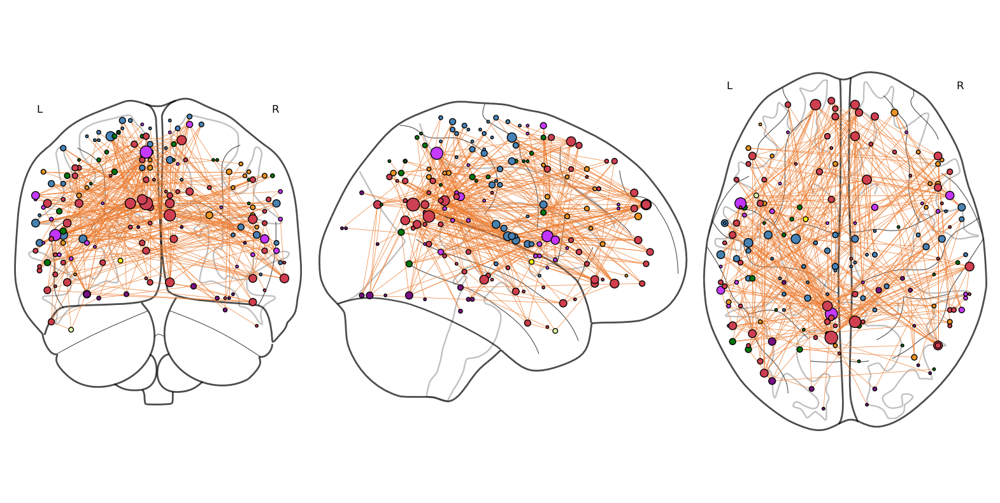

In [197]:
fig, ax = plt.subplots(1,1,figsize=(20,10))
fig_f1GTf2_brain = plot_connectome(data_f1GTf2,roi_info[['pos_R','pos_A','pos_S']],node_color=roi_info['RGB'], node_size=10*Gnt_f1GTf2['Degree'], edge_kwargs={'linewidth':.5, 'color':'#ED7D31'}, node_kwargs={'linewidth':1, 'edgecolor':'k'}, axes=ax)

In [198]:
fig_f1GTf2_brain.savefig('./figures/fig_f1GTf2-brain.png')

In [160]:
view_connectome(data_f1GTf2,roi_info[['pos_R','pos_A','pos_S']],node_color=roi_info['RGB'], node_size=Gnt_f1GTf2['Degree'], linewidth=.5)

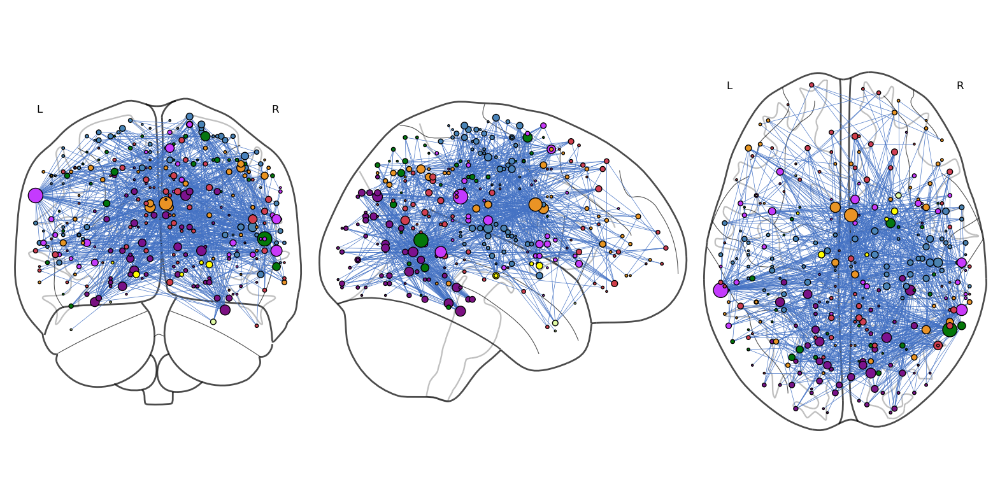

In [200]:
fig, ax = plt.subplots(1,1,figsize=(20,10))
fig_f2GTf1_brain = plot_connectome(data_f2GTf1,roi_info[['pos_R','pos_A','pos_S']],node_color=roi_info['RGB'], node_size=5*Gnt_f2GTf1['Degree'], edge_kwargs={'linewidth':.5, 'color':'#4472C4'}, node_kwargs={'linewidth':1, 'edgecolor':'k'}, axes=ax)
fig_f2GTf1_brain.savefig('./figures/fig_f2GTf1-brain.png')

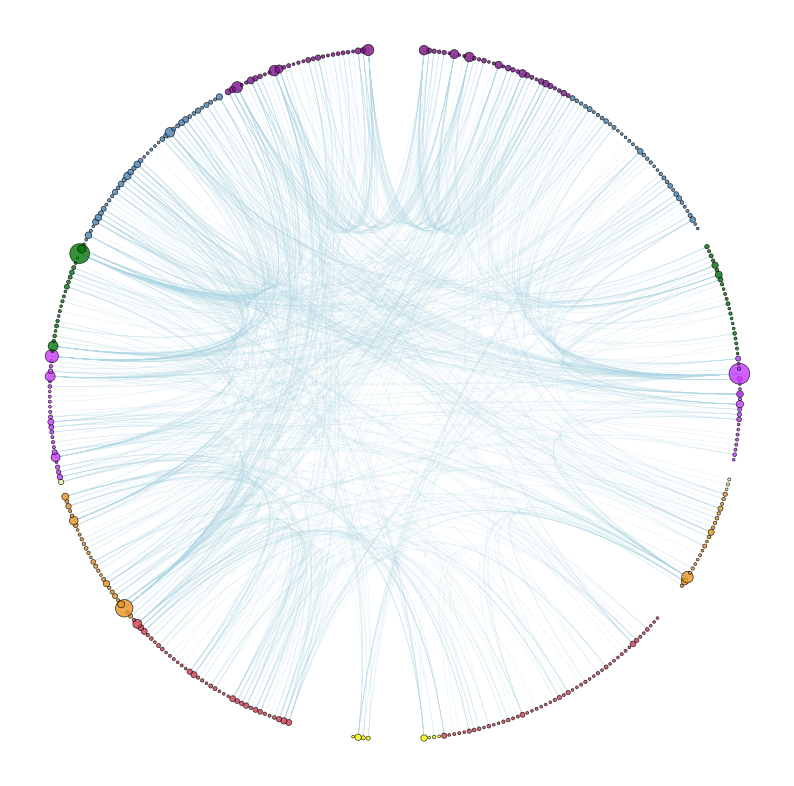

In [167]:
fig_f2GTf1

In [163]:
@pn.depends(behav_select)
def gather_interactive_brain_view(behavior):
    G = nx.from_pandas_adjacency(model_consensus_to_plot[behavior].abs())
    d = [val for node,val in G.degree()]
    plot = plot_connectome(model_consensus_to_plot[behavior],roi_info[['pos_R','pos_A','pos_S']], node_color=roi_info['RGB'], node_size=d) #, linewidth=1, colorbar_fontsize=10, node_size=d)
    return plot

AttributeError: module 'numpy' has no attribute 'depends'

In [152]:
Gnt_f2GTf1.hvplot.kde(y='Degree', label='F2 > F1') * Gnt_f1GTf2.hvplot.kde(y='Degree', label='F1 > F2')

:Overlay
   .Distribution.F2_greater_than_F1 :Distribution   [Degree]   (Density)
   .Distribution.F1_greater_than_F2 :Distribution   [Degree]   (Density)

In [144]:
import hvplot.pandas

In [37]:
from random import choice

import matplotlib.pyplot as plt
import networkx as nx

from nxviz.plots import CircosPlot

G = nx.barbell_graph(m1=10, m2=3)
for n, d in G.nodes(data=True):
    G.node[n]["class"] = choice(["a", "b", "c", "d", "e"])
c = CircosPlot(
    G,
    node_grouping="class",
    node_color="class",
    node_order="class",
    node_labels=True,
    group_label_position="middle",
    group_label_color=True,
    group_label_offset=2,
)
c.draw()
plt.show()

ImportError: cannot import name 'CircosPlot' from 'nxviz.plots' (/data/SFIMJGC_HCP7T/Apps/envs/fc_introspection/lib/python3.7/site-packages/nxviz/plots.py)

In [38]:
import nxviz
print(nxviz.__version__)

AttributeError: module 'nxviz' has no attribute '__version__'

In [ ]:
from nxviz.plots import 

In [11]:
import networkx as nx
from utils.plotting import get_node_positions
from nxviz.utils import node_table, edge_table
from nxviz import plots, nodes, edges, lines
import matplotlib.pyplot as plt

In [12]:
from utils.plotting import get_node_positions
from nxviz.utils import node_table, edge_table
from nxviz import plots, nodes, edges, lines
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler

In [13]:
def create_bimodal_graph_from_matrix(data):
    assert isinstance(data,pd.DataFrame),    "++ERROR [plot_as_graph]:  input data expected to be a pandas dataframe"
    assert 'ROI_ID'     in data.index.names, "++ERROR [plot_as_graph]:  input data expected to have one column named ROI_ID"
    assert 'Hemisphere' in data.index.names, "++ERROR [plot_as_graph]:  input data expected to have one column named Hemisphere"
    assert 'Network'    in data.index.names, "++ERROR [plot_as_graph]:  input data expected to have one column named Network"
    assert 'RGB'    in data.index.names,     "++ERROR [plot_as_graph]: input data expected to have one column named RGB"
    
    # Convert input to ints (this function only works for unweigthed graphs)
    fdata          = data.copy().astype('int')
    fdata.index    = fdata.index.get_level_values('ROI_ID')
    fdata.columns  = fdata.index
    
    # Create basic Graph
    # ==================
    G = nx.from_pandas_adjacency(fdata.abs())
    
    # Add information about hemisphere and network
    # ============================================
    hemi_attribs      = {row['ROI_ID']:row['Hemisphere'] for r,row in roi_info.iterrows()}
    nw_attribs        = {row['ROI_ID']:row['Network'] for r,row in roi_info.iterrows()}
    lab_attribs       = {row['ROI_ID']:row['ROI_Name'] for r,row in roi_info.iterrows()}
    col_attribs       = {row['ROI_ID']:row['RGB'] for r,row in roi_info.iterrows()}
    deg_attribs          = nx.degree_centrality(G)
    degree_centr_attribs = {r:v for r,v in zip(list(deg_attribs.keys()), MinMaxScaler(feature_range=(0.001,0.01)).fit_transform(np.array(list(nx.degree_centrality(G).values())).reshape(-1,1)).flatten())}
    degree_attribs       = dict(G.degree())
    nx.set_node_attributes(G,hemi_attribs,'Hemi')
    nx.set_node_attributes(G,nw_attribs,'Network')
    nx.set_node_attributes(G,lab_attribs,'ROI_Name')
    nx.set_node_attributes(G,col_attribs,'RGB')
    nx.set_node_attributes(G,degree_centr_attribs,'Degree_Centrality')
    nx.set_node_attributes(G,degree_attribs,'Degree')
    # Add edge attributes based on which model they represent
    # =======================================================
    # Count the input values
    val_counts = pd.Series(fdata.values.flatten()).value_counts()
    # Check for the presence of positive edges
    if 1 in val_counts.index:
        #fdata_pos will have 1s for edges in positive model, zero anywhere else
        fdata_pos              = fdata.copy()
        fdata_pos[fdata_pos<0] = 0 # Removing -1 from positive graph
        G_pos = nx.from_pandas_adjacency(fdata_pos)
    # Check for the present of negative edges
    if -1 in val_counts.index:
        #fdata_pos will have 1s for edges in negative model, zero anywhere else
        fdata_neg              = fdata.copy() * -1
        fdata_neg[fdata_neg<0] = 0    # Removing 1 from negative graph
        G_neg = nx.from_pandas_adjacency(fdata_neg)
    # Create Graph with all nodes (for positioning purposes - edges do not matter)
    # Add information about positive or negative edge
    model_attribs = {}
    if G_pos is not None:
        for edge in G_pos.edges:
            model_attribs[edge] = 'pos'
    if G_neg is not None:
        for edge in G_neg.edges:
            model_attribs[edge] = 'neg'
    nx.set_edge_attributes(G,model_attribs,'Model')
    
    return G

In [20]:
def create_unimodal_graph_from_matrix(data):
    assert isinstance(data,pd.DataFrame),    "++ERROR [plot_as_graph]:  input data expected to be a pandas dataframe"
    assert 'ROI_ID'     in data.index.names, "++ERROR [plot_as_graph]:  input data expected to have one column named ROI_ID"
    assert 'Hemisphere' in data.index.names, "++ERROR [plot_as_graph]:  input data expected to have one column named Hemisphere"
    assert 'Network'    in data.index.names, "++ERROR [plot_as_graph]:  input data expected to have one column named Network"
    assert 'RGB'    in data.index.names,     "++ERROR [plot_as_graph]: input data expected to have one column named RGB"
    
    # Convert input to ints (this function only works for unweigthed graphs)
    fdata          = data.copy().astype('int')
    fdata.index    = fdata.index.get_level_values('ROI_ID')
    fdata.columns  = fdata.index
    
    # Create basic Graph
    # ==================
    G = nx.from_pandas_adjacency(fdata)
    
    # Add information about hemisphere and network
    # ============================================
    hemi_attribs      = {row['ROI_ID']:row['Hemisphere'] for r,row in roi_info.iterrows()}
    nw_attribs        = {row['ROI_ID']:row['Network'] for r,row in roi_info.iterrows()}
    lab_attribs       = {row['ROI_ID']:row['ROI_Name'] for r,row in roi_info.iterrows()}
    col_attribs       = {row['ROI_ID']:row['RGB'] for r,row in roi_info.iterrows()}
    deg_attribs          = nx.degree_centrality(G)
    degree_centr_attribs = {r:v for r,v in zip(list(deg_attribs.keys()), MinMaxScaler(feature_range=(0.001,0.01)).fit_transform(np.array(list(nx.degree_centrality(G).values())).reshape(-1,1)).flatten())}
    degree_attribs       = dict(G.degree())
    nx.set_node_attributes(G,hemi_attribs,'Hemi')
    nx.set_node_attributes(G,nw_attribs,'Network')
    nx.set_node_attributes(G,lab_attribs,'ROI_Name')
    nx.set_node_attributes(G,col_attribs,'RGB')
    nx.set_node_attributes(G,degree_centr_attribs,'Degree_Centrality')
    nx.set_node_attributes(G,degree_attribs,'Degree')
    nx.set_node_attributes(G,nx.eigenvector_centrality(G),'Eigenvector_Centrality')
    nx.set_node_attributes(G,nx.pagerank(G),'Page_Rank')

    # Add edge attributes based on which model they represent
    # =======================================================
    # Count the input values
    val_counts = pd.Series(fdata.values.flatten()).value_counts()
    # Check for the presence of positive edges
    if 1 in val_counts.index:
        #fdata_pos will have 1s for edges in positive model, zero anywhere else
        fdata_pos              = fdata.copy()
        fdata_pos[fdata_pos<0] = 0 # Removing -1 from positive graph
        G_pos = nx.from_pandas_adjacency(fdata_pos)
    model_attribs = {}
    if G_pos is not None:
        for edge in G_pos.edges:
            model_attribs[edge] = 'pos'
    nx.set_edge_attributes(G,model_attribs,'Model')
    
    return G

In [75]:
G     = create_unimodal_graph_from_matrix(data_f1GTf2)
G_att = node_table(G)
N_rois = G_att.shape[0]

In [70]:
G_att.sort_values(by='Degree', ascending=False)[0:10]

,Hemisphere,Network,ROI_Name,RGB,ROI_ID,Degree_Centrality,Degree,Eigenvector_Centrality,Page_Rank,Size,Alpha
182,LH,Default,LH_Default_pCunPCC_6,#cd4155,182,0.010000,21,0.354488,0.021927,0.015000,0.8
112,LH,SalVentAttn,LH_SalVentAttn_Med_6,#c53afe,112,0.009143,19,0.071296,0.021705,0.013762,0.8
371,RH,Default,RH_Default_pCunPCC_4,#d03f50,371,0.008286,17,0.316675,0.016561,0.012524,0.8
105,LH,SalVentAttn,LH_SalVentAttn_FrOperIns_9,#c134fa,105,0.007857,16,0.149207,0.016886,0.011905,0.8
166,LH,Default,LH_Default_PFC_14,#cd4050,166,0.007000,14,0.220412,0.014845,0.010667,0.8
183,LH,Default,LH_Default_pCunPCC_7,#cd4156,183,0.006143,12,0.267968,0.011297,0.009429,0.8
367,RH,Default,RH_Default_PFCdPFCm_13,#d03f4e,367,0.005714,11,0.080718,0.013715,0.008810,0.8
61,LH,SomMot,LH_SomMot_30,#4683b9,61,0.005714,11,0.258100,0.010762,0.008810,0.8
355,RH,Default,RH_Default_PFCdPFCm_1,#d03e49,355,0.005286,10,0.122671,0.011909,0.008190,0.8
361,RH,Default,RH_Default_PFCdPFCm_7,#d03e50,361,0.005286,10,0.157349,0.010761,0.008190,0.8


***

In [1]:
from glob import glob
from nilearn import masking
from nimare.stats import pearson
from sklearn.preprocessing import MinMaxScaler
from nxviz.utils import node_table
import pickle
import os
import panel as pn
import seaborn as sns
import networkx as nx
from wordcloud import WordCloud
import matplotlib.pyplot as plt
from PIL import Image
vocab = 'LDA400'

/data/SFIMJGC_HCP7T/Apps/envs/fc_introspection/lib/python3.7/site-packages/nilearn/__init__.py:69: FutureWarning: Python 3.7 support is deprecated and will be removed in release 0.12 of Nilearn. Consider switching to Python 3.9 or 3.10.
  _python_deprecation_warnings()
/data/SFIMJGC_HCP7T/Apps/envs/fc_introspection/lib/python3.7/site-packages/nimare/__init__.py:74: FutureWarning: Python 3.6 and 3.7 support is deprecated and will be removed in release 0.1.0 of NiMARE. Consider switching to Python 3.8, 3.9 or 3.10.
  _python_deprecation_warnings()
/data/SFIMJGC_HCP7T/Apps/envs/fc_introspection/lib/python3.7/site-packages/nxviz/__init__.py:29: UserWarning: 
nxviz has a new API! Version 0.7.4 onwards, the old class-based API is being
deprecated in favour of a new API focused on advancing a grammar of network
graphics. If your plotting code depends on the old API, please consider
pinning nxviz at version 0.7.4, as the new API will break your old code.

To check out the new API, please head 

In [2]:
nimare_metamaps_flip_folder = f'/data/SFIMJGC_Introspec/prj2021_dyneusr/Resources_NiMare/{vocab}/meta-analyses-RPI'
nimare_decoding_mask_path   = '/data/SFIMJGC_Introspec/2023_fc_introspection/nimare/NiMare_Decoding_Mask_GMribbon_2023.nii.gz'
atlas_mask                  = '/data/SFIMJGC_Introspec/2023_fc_introspection/nimare/Schaefer2018_400Parcels_7Networks_AAL2_Decoding_Template.nii.gz'

In [3]:
# Get the meta-analytic files and their names
label_files = sorted(glob(os.path.join(nimare_metamaps_flip_folder, "*_z_desc-specificity.nii.gz")))
labels = [os.path.basename(filename).split("_z")[0] for filename in label_files]

In [4]:
%%time
# Extract the data as a meta-analysis-by-voxel array
meta_data = masking.apply_mask(label_files,nimare_decoding_mask_path)
print(meta_data.shape)

(400, 119303)
CPU times: user 25.8 s, sys: 1.2 s, total: 27 s
Wall time: 40.5 s


In [158]:
atlas_vector = masking.apply_mask(atlas_mask, nimare_decoding_mask_path)
print(atlas_vector.shape)

(119303,)


In [159]:
inputs={'f1GTf2':data_f1GTf2,'f2GTf1':data_f2GTf1}

In [160]:
decoding_results = {}
for comparison in ['f1GTf2','f2GTf1']:
    for metric in ['Degree','Eigenvector_Centrality','Page_Rank']:
        output_vector = np.zeros(atlas_vector.shape)
        
        G     = create_unimodal_graph_from_matrix(inputs[comparison])
        G_att = node_table(G)
        N_rois = G_att.shape[0]

        for roi in range(N_rois):
            output_vector[atlas_vector==roi+1] = G_att.loc[roi+1,metric]
        
        output_img = masking.unmask(output_vector,nimare_decoding_mask_path)
        output_path = f'/data/SFIMJGC_Introspec/2023_fc_introspection/nimare/{comparison}_{metric}.nii'
        output_img.to_filename(output_path)
        
        # Decoding
        # ========
        # 1. Load Map (redundant in this loop)
        img_vec = masking.apply_mask(output_path, nimare_decoding_mask_path)
        # 2. Perform the correlation between the two arrays
        correlations = pearson(img_vec, meta_data)
        # 3. Create a dataframe with the correlations
        decoding_results[comparison,metric] = pd.DataFrame(index=labels, columns=["r"], data=correlations)

<AxesSubplot:>

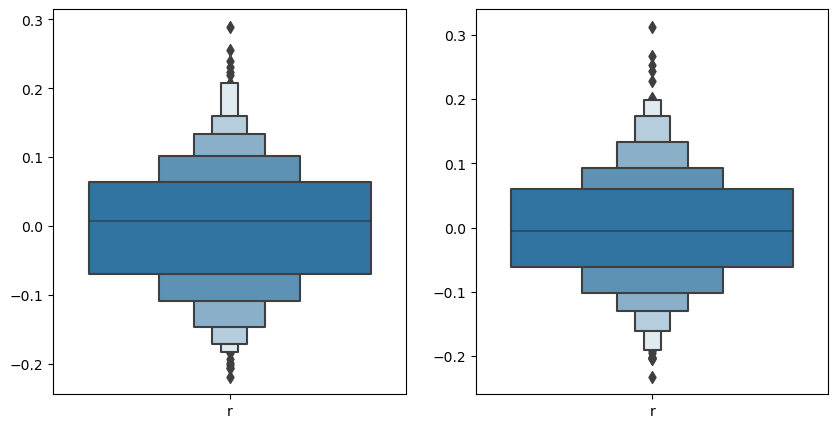

In [308]:
fig,axs = plt.subplots(1,2,figsize=(10,5))
sns.boxenplot(decoding_results[('f1GTf2','Eigenvector_Centrality')], ax=axs[0],),
sns.boxenplot(decoding_results[('f2GTf1','Eigenvector_Centrality')], ax=axs[1])

In [309]:
topic_term_list_path = f'/data/SFIMJGC_Introspec/prj2021_dyneusr/Resources_NiMare/{vocab}/neurosynth/data-neurosynth_version-7_vocab-{vocab}_keys.tsv'
topic_term_list = pd.read_csv(topic_term_list_path, sep='\t', header=None)
topic_term_list.columns=['Topic_ID','Unknown','Terms']

In [310]:
top_topics = {'f1GTf2':decoding_results[('f1GTf2','Eigenvector_Centrality')][decoding_results[('f1GTf2','Eigenvector_Centrality')]['r'] > .2],
              'f2GTf1':decoding_results[('f2GTf1','Eigenvector_Centrality')][decoding_results[('f2GTf1','Eigenvector_Centrality')]['r'] > .2]}

In [311]:
pn.Row(pn.pane.DataFrame(top_topics['f1GTf2'].sort_values(by='r', ascending=False), width=500), 
       pn.pane.DataFrame(top_topics['f2GTf1'].sort_values(by='r', ascending=False), width=500))

Row
    [0] DataFrame(DataFrame, width=500)
    [1] DataFrame(DataFrame, width=500)

In [386]:
x, y = np.ogrid[:300, :300]
sphere_mask = (x - 150) ** 2 + (y - 150) ** 2 > 130 ** 2
sphere_mask = 255 * sphere_mask.astype(int)

In [387]:
brain_mask = np.array(Image.open("/data/SFIMJGC_Introspec/2023_fc_introspection/Brain_300.png"))
brain_mask = brain_mask > 100
brain_mask = 255 * brain_mask.astype(int)

In [404]:
this_topic_weights= {}
wc = {}
for contrast in top_topics.keys():
    this_topic_weights[contrast] = {}
    for topic in top_topics[contrast].index:
        this_topic_r     = top_topics[contrast].loc[topic,'r']
        this_topic_id    = int(topic.split('_')[4])
        this_topic_terms = topic_term_list.loc[this_topic_id,'Terms'].split(' ')[0:20][::-1] # 20 is what's available in NeuroSynth
        for term in this_topic_terms:
            if term in this_topic_weights[contrast]:
                this_topic_weights[contrast][term] = this_topic_weights[contrast][term] + (this_topic_r * (this_topic_terms.index(term) + 1))
            else:
                this_topic_weights[contrast][term] = this_topic_r * (this_topic_terms.index(term) + 1)
    wc[contrast] = WordCloud(max_font_size=50, 
               contour_color='steelblue', contour_width=3,  max_words=25,
               background_color='white', 
               repeat=True, mask=brain_mask).fit_words(this_topic_weights[contrast])

(-0.5, 304.5, 304.5, -0.5)

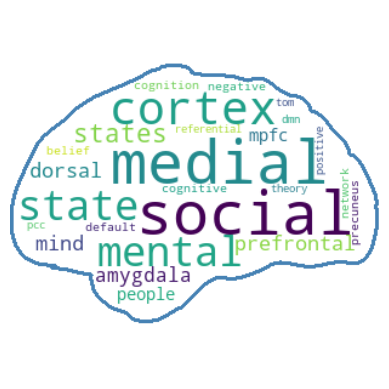

In [405]:
plt.imshow(wc['f1GTf2'],interpolation='bilinear')
plt.axis('off')

(-0.5, 304.5, 304.5, -0.5)

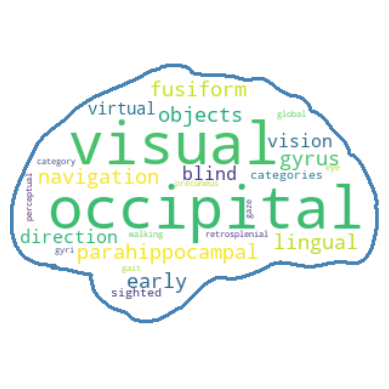

In [406]:
plt.imshow(wc['f2GTf1'],interpolation='bilinear')
plt.axis('off')

In [55]:
decoding_results['f1GTf2','Degree']

,r
LDA50_abstract_weight__0_network_state_resting,0.227833
LDA50_abstract_weight__10_food_taste_weight,-0.019034
LDA50_abstract_weight__11_learning_training_practice,-0.138284
LDA50_abstract_weight__12_women_men_sex,0.081988
LDA50_abstract_weight__13_fear_threat_smokers,0.020918
LDA50_abstract_weight__14_disease_ad_pd,0.060268
LDA50_abstract_weight__15_task_performance_cognitive,-0.103839
LDA50_abstract_weight__16_response_inhibition_control,-0.072428
LDA50_abstract_weight__17_motor_cortex_hand,-0.072619
LDA50_abstract_weight__18_number_ips_numerical,-0.096907


In [49]:
lda_model_path = '/data/SFIMJGC_Introspec/prj2021_dyneusr/Resources_NiMare/LDA50/lda_model.pkl.gz'
with open(lda_model_path,'rb') as f:
    model_results = pickle.load(f)

In [52]:
model = model_results['model']

In [53]:
n_top_terms = 10
top_term_df = model.distributions_["p_topic_g_word_df"].T
temp_df = top_term_df.copy()
top_term_df = pd.DataFrame(columns=top_term_df.columns, index=range(n_top_terms))
top_term_df.index.name = "Token"
for col in top_term_df.columns:
    top_tokens = temp_df.sort_values(by=col, ascending=False).index.tolist()[:n_top_terms]
    top_term_df.loc[:, col] = top_tokens

top_term_df

,LDA50__1_adhd_pd_task,LDA50__2_functional_hallucinations_deception,LDA50__3_bold_signal_level,LDA50__4_children_adolescents_age,LDA50__5_functional_anterior_navigation,LDA50__6_depression_mdd_treatment,LDA50__7_pet_tomography_emission,LDA50__8_learning_learned_sequence,LDA50__9_gyrus_frontal_inferior,LDA50__10_language_semantic_word,...,LDA50__41_task_rotation_mental,LDA50__42_self_cortex_mpfc,LDA50__43_effects_women_expressions,LDA50__44_eeg_frequency_white,LDA50__45_rule_cortex_events,LDA50__46_conflict_control_acc,LDA50__47_sleep_cortex_prefrontal,LDA50__48_music_musical_temporal,LDA50__49_visual_auditory_cortex,LDA50__50_basal_ganglia_basal ganglia
Token,,,,,,,,,,,,,,,,,,,,,
0,adhd,functional,bold,children,functional,depression,pet,learning,gyrus,language,...,task,self,effects,eeg,rule,conflict,sleep,music,visual,basal
1,pd,hallucinations,signal,adolescents,anterior,mdd,tomography,learned,frontal,semantic,...,rotation,cortex,women,frequency,cortex,control,cortex,musical,auditory,ganglia
2,task,deception,level,age,navigation,treatment,emission,sequence,inferior,word,...,mental,mpfc,expressions,white,events,acc,prefrontal,temporal,cortex,basal ganglia
3,cortex,magnetic,blood,development,using,controls,positron,behavioral,frontal gyrus,words,...,tasks,medial,healthy,white matter,future,task,task,creative,sensory,acupuncture
4,functional,magnetic resonance,response,adults,time,reho,positron emission,functional,temporal,reading,...,cognitive,prefrontal,placebo,hz,rules,cortex,cognitive,functional,modality,cortical
5,controls,resonance,bold signal,years,magnetic,depressive,emission tomography,implicit,superior,sentences,...,mental rotation,prefrontal cortex,stress,ms,information,interference,prefrontal cortex,creativity,stimuli,nucleus
6,parkinson,cortex,using,developmental,cortex,cortical,gm volume,performance,middle,comprehension,...,using,medial prefrontal,amygdala,fa,comt,anterior,functional,response,visual cortex,motor
7,parkinson disease,ot,oxygen,task,resonance,state,rcbf,response,inferior frontal,phonological,...,suggest,empathy,facial,diffusion,prefrontal,cingulate,effects,task,temporal,control
8,control,using,level bold,group,response,alff,metabolism,early,parietal,lexical,...,high,anterior,men,cortical,met,cognitive,deprivation,verbal,information,thalamus


In [69]:
(model.distributions_['p_topic_g_word_df'].loc['LDA50__10_language_semantic_word']/model.distributions_['p_topic_g_word_df'].sum(axis=1)['LDA50__10_language_semantic_word']).sort_values(ascending=False)

language         3.531963e-02
semantic         2.901211e-02
word             2.332824e-02
words            2.243235e-02
reading          2.164428e-02
                     ...     
fc prefrontal    1.306232e-08
fc primarily     1.306232e-08
fc primary       1.306232e-08
fc provide       1.306232e-08
zusanli          1.306232e-08
Name: LDA50__10_language_semantic_word, Length: 187491, dtype: float64